## import 및 데이터 전처리

In [3]:
import pandas as pd
from nltk.tokenize import word_tokenize
from gensim.models.doc2vec import TaggedDocument, Doc2Vec
from tqdm import tqdm
import os
import nltk

# punkt 다운로드
nltk.data.path.append("/home/st_group_1/anaconda3/envs/duu/nltk_data")
nltk.download('punkt_tab', download_dir="/home/st_group_1/anaconda3/envs/duu/nltk_data")

print("현재위치 : ", os.getcwd())

try:
    nltk.data.find('tokenizers/punkt')
    print("punkt 데이터가 정상적으로 설치되었습니다.")
except LookupError:
    print("punkt 데이터가 설치되지 않았습니다.")


현재위치 :  /home/st_group_1/yuvnn/pjt_Discriminate-untrusted-users
punkt 데이터가 정상적으로 설치되었습니다.


[nltk_data] Downloading package punkt_tab to
[nltk_data]     /home/st_group_1/anaconda3/envs/duu/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


In [2]:
import pandas as pd
df = pd.read_feather('./rating_merged.feather')
df.head(10)

,ID,content of review
0,2815.0_Adult Products,Talk Dirty to Me is brilliant. When you ar...
1,11996.0_Adult Products,I have had this game for about 15 years an...
2,5001156.0_Adult Products,I love K.Y Jelly. It is one of those produ...
3,5002475.0_Adult Products,The battle of the sexes. The ultimate game...
4,5016738.0_Adult Products,I suppose the only way to tackle an opinio...
5,5017708.0_Adult Products,"As it s after the watershed , I thought I..."
6,5035572.0_Adult Products,"Once a month, if you are having periods, y..."
7,5035648.0_Adult Products,"Now, before you all jump to the conclusion..."
8,5046112.0_Adult Products,This game is perfect for parties It s not...
9,5050984.0_Adult Products,The Battle of the Sexes - it says it all r...


In [5]:
df['content of review'] = df['content of review'].fillna("").astype(str)

tagged_corpus_list = []

for index, row in tqdm(df.iterrows(), total=len(df)):
    text = row['content of review']
    tag = row['ID']
    # 영어 문장을 단어 단위로 토큰화
    tokenized_text = word_tokenize(text.lower())  # 소문자로 변환하여 일관성 유지
    tagged_corpus_list.append(TaggedDocument(tags=[tag], words=tokenized_text))

print('문서의 수 :', len(tagged_corpus_list))

  0%|          | 0/66877 [00:00<?, ?it/s]

100%|██████████| 66877/66877 [12:41<00:00, 87.85it/s]  

문서의 수 : 66877


In [6]:
tagged_corpus_list[1]

TaggedDocument(words=['i', 'have', 'had', 'this', 'game', 'for', 'about', '15', 'years', 'and', 'have', 'played', 'it', 'a', 'total', 'of', '2', 'times', ',', 'that', 'is', 'how', 'boring', 'it', 'is.it', 'is', 'supposed', 'to', 'be', 'an', 'adult', 'after', 'dinner', 'game', '.', 'one', 'that', 'brings', 'out', 'the', 'truth', 'about', 'people', 'and', 'how', 'decietful', 'people', 'are', 'that', 'you', 'once', 'trusted.the', 'game', 'asks', 'you', 'some', 'severely', 'difficult', 'questions', 'about', 'a', 'ituation', 'and', 'what', 'you', 'would', 'do', 'in', 'that', 'situation', '.', 'other', 'players', 'have', 'to', 'guess', 'your', 'answer.its', 'a', 'bit', 'pointless', 'because', 'if', 'you', 'know', 'someone', 'really', 'well', ',', 'you', 'can', 'normally', 'predict', 'their', 'answer', 'really', 'well.then', 'again', ',', 'you', 'can', 'see', 'a', 'completely', 'different', 'side', 'to', 'someone', 'when', 'playing', 'this', 'game.i', 'played', 'it', 'many', 'moons', 'ago', '

## doc2vec학습 및 테스트

In [7]:
from gensim.models import doc2vec

model = doc2vec.Doc2Vec(vector_size=300, alpha=0.025, min_alpha=0.025, workers=8, window=8)

# Vocabulary 빌드
model.build_vocab(tagged_corpus_list)

# Doc2Vec 학습
model.train(tagged_corpus_list, total_examples=model.corpus_count, epochs=20)

# 모델 저장
model.save('dart.doc2vec')

In [8]:
tag_embedding = model.dv[2]  # 또는 model.docvecs[tag]

print("임베딩 벡터:", tag_embedding)
print("임베딩 크기:", tag_embedding.shape)

임베딩 벡터: [ 0.21064426 -1.0086138  -0.9736675  -0.65906656 -0.10618169 -0.74925274
 -1.4238927   0.20839764 -0.5988706  -0.6000778  -0.2744272   2.1895902
 -1.3556927   0.07822359 -1.1942875   0.5768112  -0.98668635 -1.5599359
 -0.6466817   0.8767962  -0.707623    1.2194837   0.41310173  0.41169295
  0.71230775 -0.2546674   0.51539046 -0.403552   -1.5850952  -0.5431131
  0.8751024   0.37937486  2.3413641   1.4731959  -0.5048991   0.7551272
 -1.2217073   0.11409365  0.89441144  1.639281    0.48686764  0.17304878
 -0.08000031  0.65650153 -0.03255495 -1.043341   -0.4233968   2.1593199
  0.58453906  0.51897436 -1.0676149   0.26526156  0.51537466 -0.06859427
 -0.33413666 -0.09553875 -1.6620624   0.82038206  2.4582891   1.613772
  1.0571928   0.25490835 -0.30677277  0.6338507  -0.12597573 -0.91488653
  2.1244073   0.71928906 -1.6364294  -2.1403713  -0.84100556 -0.47286347
 -1.0339696  -0.9343759   1.1053084  -0.64512     0.5162297  -1.02713
 -0.69748676 -0.63253474 -0.6976953   0.66311955 -0.0

In [10]:
# 각 문서의 벡터를 추출하고 'ID'와 함께 저장
docvecs = [model.dv[doc_id] for doc_id in df['ID']]

# 벡터를 문자열로 변환 (각 벡터를 공백으로 구분하여 하나의 문자열로 저장)
df['embedding'] = [ ' '.join(map(str, vec)) for vec in docvecs ]

# 필요한 컬럼만 추출
df_vectors = df[['ID', 'embedding']]

# CSV로 저장
df_vectors.to_csv('document_vectors.csv', index=False)

## 결과 시각화

In [3]:
import plotly.express as px
import pandas as pd
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from gensim.models import doc2vec

# dart.doc2vec 모델 로드
model = doc2vec.Doc2Vec.load("dart.doc2vec")  # 수정된 부분

# 예시로 df['content of review']에서 얻은 임베딩 벡터 사용
# 각 문서에 대한 벡터를 추출
docvecs = [model.dv[doc_id] for doc_id in df['ID']]

# ID에서 userID 추출 (userid_category 형태에서 userID만 추출)
df['userID'] = df['ID'].apply(lambda x: x.split('_')[0])

# 차원 축소 (PCA)
pca = PCA(n_components=3)
docvecs_3d = pca.fit_transform(docvecs)  # docvecs를 PCA로 3D 차원 축소

# 시각화하기 위한 DataFrame 생성
df_tsne = pd.DataFrame(docvecs_3d, columns=['x', 'y', 'z'])

# df에서 userID 컬럼 추가
df_tsne['userID'] = df['userID']

# Plotly로 3D scatter plot 생성s
fig = px.scatter_3d(df_tsne, x='x', y='y', z='z', color='userID',
                    title="3D Visualization of Embeddings",
                    labels={'userID': 'User ID'})

# Plotly 그래프를 Matplotlib으로 변환 후 저장
fig.write_image("embedding_visualization.png")  # 저장할 파일 이름을 지정

# 그래프 출력
fig.show()


In [4]:
import plotly.express as px
import pandas as pd
from sklearn.decomposition import PCA

# dart.doc2vec 모델 로드
model = Doc2Vec.load("dart.doc2vec")

# 예시로 df['content of review']에서 얻은 임베딩 벡터 사용
# 각 문서에 대한 벡터를 추출
docvecs = [model.dv[doc_id] for doc_id in df['ID']]

# ID에서 userID 추출 (userid_category 형태에서 userID만 추출)
df['category'] = df['ID'].apply(lambda x: x.split('_')[1])

# docvecs는 임베딩 벡터입니다. 예시로 df['content of review']에서 얻은 임베딩 벡터 사용
# 여기서는 docvecs가 이미 주어진 임베딩 벡터라고 가정합니다.

# 차원 축소 (PCA)
pca = PCA(n_components=3)
docvecs_3d = pca.fit_transform(docvecs)  # docvecs를 PCA로 3D 차원 축소

# 시각화하기 위한 DataFrame 생성
df_tsne = pd.DataFrame(docvecs_3d, columns=['x', 'y', 'z'])

# df에서 userID 컬럼 추가
df_tsne['category'] = df['category']

# userID별 색상 매핑
category_colors = {user: color for user, color in zip(df_tsne['category'].unique(), px.colors.qualitative.Set1)}

# Plotly로 3D scatter plot 생성
fig = px.scatter_3d(df_tsne, x='x', y='y', z='z', color='category',
                    title="3D Visualization of Embeddings",
                    labels={'category': 'category'},
                    color_discrete_map=category_colors)

# 점 크기 조절 (size_max를 사용하여 크기 제한)
fig.update_traces(marker=dict(size=3))  # 점 크기를 3으로 설정 (디폴트는 6)

# 그래프 출력
fig.show()


### 사용x

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import matplotlib.cm as cm

# 학습된 doc2vec 모델에서 모든 문서 벡터 가져오기
doc_vectors = np.array([model.dv[i] for i in range(len(model.dv))])

# PCA로 3차원으로 축소
pca = PCA(n_components=3)
doc_vectors_3d = pca.fit_transform(doc_vectors)

# df에서 index -> userID 매핑
# index_to_userID = df.set_index("index")["UserID"].to_dict()
# df에서 index -> category 매핑
index_to_userID = df.set_index("ID")["content of review"].to_dict()

# 각 문서(tag)의 userID 가져오기
userIDs = [index_to_userID[i] for i in range(len(model.dv))]


# 고유한 userID 리스트
userIDs = list(map(str, userIDs))
unique_userIDs = sorted(set(userIDs))  # 순서를 유지해서 색상을 일정하게 할당

# 컬러맵에서 고유한 색상 생성 (0~1 사이의 값을 사용해 색상 분포 균일하게 유지)
cmap = cm.get_cmap("hsv", len(unique_userIDs))
userID_to_color = {uid: cmap(i) for i, uid in enumerate(unique_userIDs)}

# 각 데이터의 userID에 맞는 색상 할당
colors = np.array([userID_to_color[uid] for uid in userIDs])

# 3D 시각화
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(doc_vectors_3d[:, 0], doc_vectors_3d[:, 1], doc_vectors_3d[:, 2], 
                c=colors, alpha=0.7)

ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")
plt.title("Doc2Vec Embeddings PCA Visualization by Category")

plt.show()


KeyError: 0

/tmp/ipykernel_451630/3537372373.py:26: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("hsv", len(unique_userIDs))


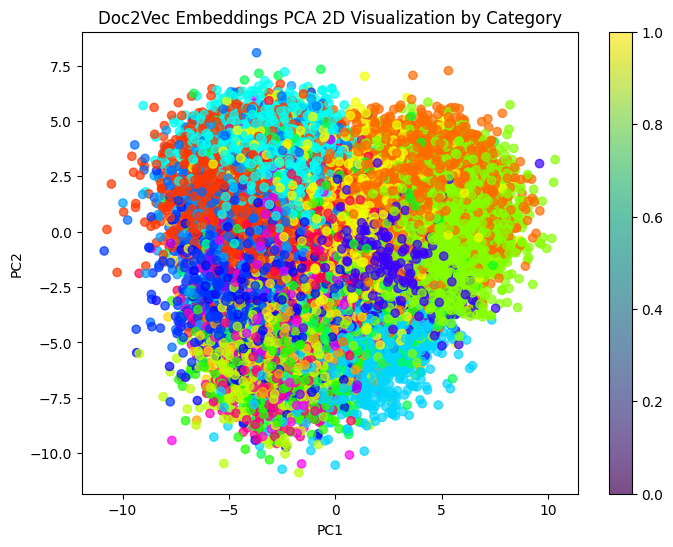

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import matplotlib.cm as cm

# 학습된 doc2vec 모델에서 모든 문서 벡터 가져오기
doc_vectors = np.array([model.dv[i] for i in range(len(model.dv))])

# PCA로 2차원으로 축소
pca = PCA(n_components=2)
doc_vectors_2d = pca.fit_transform(doc_vectors)

# df에서 다른 UserID 매핑
# index_to_userID = df.set_index("index")["UserID"].to_dict()
# df에서 index -> category 매핑
index_to_userID = df.set_index("ID")["Categories of the products"].to_dict()

# 각 문서(tag)의 userID 가져오기
userIDs = [index_to_userID[i] for i in range(len(model.dv))]
userIDs = list(map(str, userIDs))

# 고유한 userID 리스트
unique_userIDs = sorted(set(userIDs))  # 정렬해서 색상 일관되게 유지

# 컬러맵에서 고유한 색상 생성
cmap = cm.get_cmap("hsv", len(unique_userIDs))
userID_to_color = {uid: cmap(i) for i, uid in enumerate(unique_userIDs)}

# 각 데이터의 userID에 맞는 색상 할당
colors = np.array([userID_to_color[uid] for uid in userIDs])

# 2D 시각화
plt.figure(figsize=(8, 6))
plt.scatter(doc_vectors_2d[:, 0], doc_vectors_2d[:, 1], c=colors, alpha=0.7)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Doc2Vec Embeddings PCA 2D Visualization by Category")
plt.colorbar()  # 색상 바 추가
plt.show()